In [1]:
#https://stackoverflow.com/questions/52771328/plotly-chart-not-showing-in-jupyter-notebook
import plotly.offline as pyo
# Set notebook mode to work in offline
pyo.init_notebook_mode()

In [3]:
import pandas as pd
import plotly.express as px

# load / reset df
df = pd.read_csv("https://raw.githubusercontent.com/rfordatascience/tidytuesday/2e9bd5a67e09b14d01f616b00f7f7e0931515d24/data/2020/2020-07-07/coffee_ratings.csv")
df = df.rename(columns={'country_of_origin': 'origin', 'total_cup_points': 'points'})
df = df[df['points']>65]
df = df[~df['origin'].isna()]
df['origin'] = df['origin'].str.replace("?","'")

In [9]:
df.head()
# How do I get coffee cup score by country? 

,points,species,owner,origin,farm_name,lot_number,mill,ico_number,company,altitude,...,color,category_two_defects,expiration,certification_body,certification_address,certification_contact,unit_of_measurement,altitude_low_meters,altitude_high_meters,altitude_mean_meters
0,90.58,Arabica,metad plc,Ethiopia,metad plc,NaN,metad plc,2014/2015,metad agricultural developmet plc,1950-2200,...,Green,0,"April 3rd, 2016",METAD Agricultural Development plc,309fcf77415a3661ae83e027f7e5f05dad786e44,19fef5a731de2db57d16da10287413f5f99bc2dd,m,1950.0,2200.0,2075.0
1,89.92,Arabica,metad plc,Ethiopia,metad plc,NaN,metad plc,2014/2015,metad agricultural developmet plc,1950-2200,...,Green,1,"April 3rd, 2016",METAD Agricultural Development plc,309fcf77415a3661ae83e027f7e5f05dad786e44,19fef5a731de2db57d16da10287413f5f99bc2dd,m,1950.0,2200.0,2075.0
2,89.75,Arabica,grounds for health admin,Guatemala,"san marcos barrancas ""san cristobal cuch",NaN,NaN,NaN,NaN,1600 - 1800 m,...,NaN,0,"May 31st, 2011",Specialty Coffee Association,36d0d00a3724338ba7937c52a378d085f2172daa,0878a7d4b9d35ddbf0fe2ce69a2062cceb45a660,m,1600.0,1800.0,1700.0
3,89.00,Arabica,yidnekachew dabessa,Ethiopia,yidnekachew dabessa coffee plantation,NaN,wolensu,NaN,yidnekachew debessa coffee plantation,1800-2200,...,Green,2,"March 25th, 2016",METAD Agricultural Development plc,309fcf77415a3661ae83e027f7e5f05dad786e44,19fef5a731de2db57d16da10287413f5f99bc2dd,m,1800.0,2200.0,2000.0
4,88.83,Arabica,metad plc,Ethiopia,metad plc,NaN,metad plc,2014/2015,metad agricultural developmet plc,1950-2200,...,Green,2,"April 3rd, 2016",METAD Agricultural Development plc,309fcf77415a3661ae83e027f7e5f05dad786e44,19fef5a731de2db57d16da10287413f5f99bc2dd,m,1950.0,2200.0,2075.0


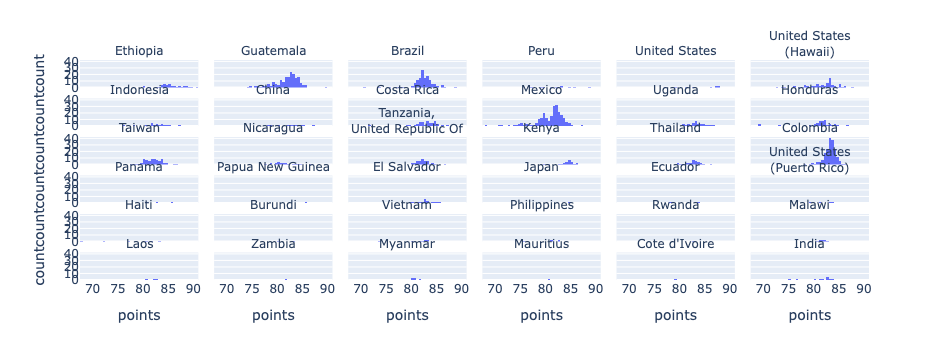

In [5]:

# fix titles
df.origin = df.origin.str.replace(" (", "<br>(")
df.origin = df.origin.str.replace(", ", ",<br>")

fig = px.histogram(df, x='points', facet_col='origin', 
             facet_col_wrap=6, height=1000, facet_row_spacing=0.05)

fig.for_each_annotation(lambda a: a.update(text=a.text.replace("origin=", ""))) # fix titles

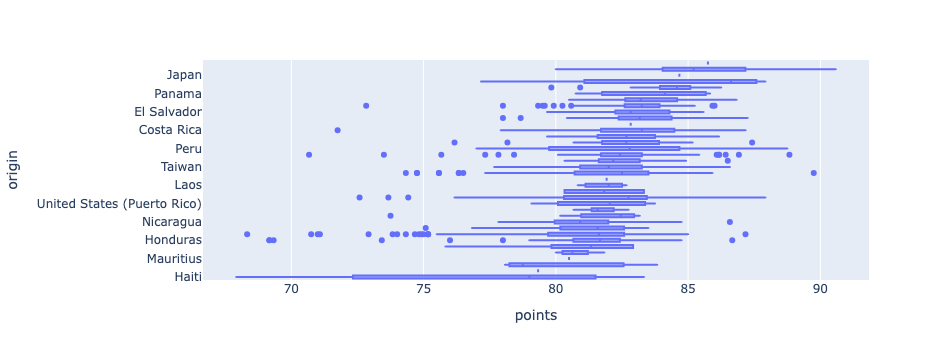

In [11]:
df.origin = df.origin.str.replace("<br>", " ") # fix labels

fig = px.box(df, x='points', y="origin", height=750)

# order plot to be more visually interpretable
fig.update_yaxes(categoryorder='array', 
                 categoryarray=df.groupby("origin")['points'].mean().sort_values().index)

We don't know the sample size in the box. 

bar graphs won't show its bimodal. 

Both forms are data are good, and one is not better than the other. 
- Histograms show shape
- Boxplot - shows the comparison. 


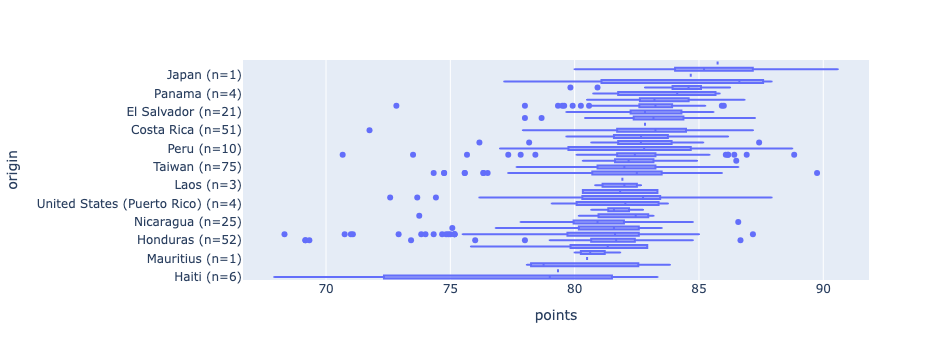

In [13]:
# add in missing sample sizes
keys = df.origin.value_counts().index.values
vals = df.origin.value_counts().index.values + " (n="+df.origin.value_counts().values.astype(str)+")"
df.origin = df.origin.map({k:v for k,v in zip(keys,vals)})

fig = px.box(df, x='points', y="origin", height=750)
fig.update_yaxes(categoryorder='array', 
                 categoryarray=df.groupby("origin")['points'].mean().sort_values().index)

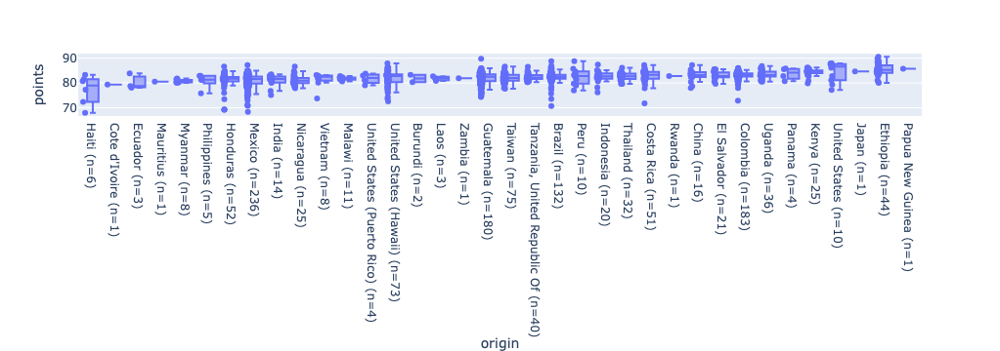

In [15]:
fig = px.box(df, y='points', x="origin", points="all", height=750) #Data swarm, like a swarm of wasps. 
# Data swarm!!
fig.update_xaxes(categoryorder='array', 
                 categoryarray=df.groupby("origin")['points'].mean().sort_values().index)

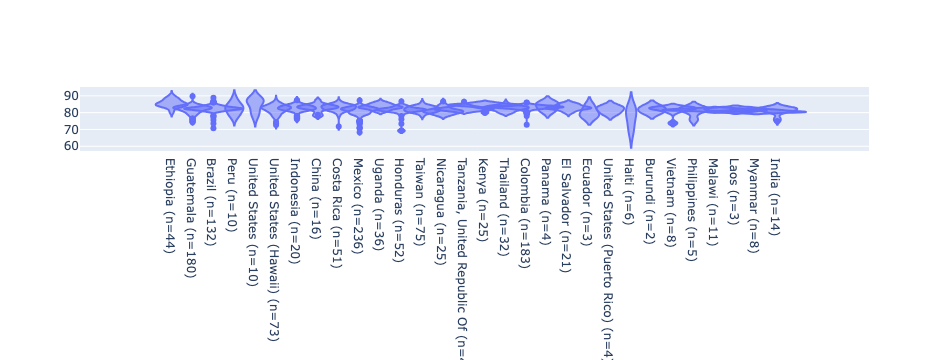

In [19]:

# https://plotly.com/python/violin/#split-violin-plot
import plotly.graph_objects as go
fig = go.Figure()
fig.add_trace(go.Violin(x=df.origin, y=df.points, side='both', width=5))

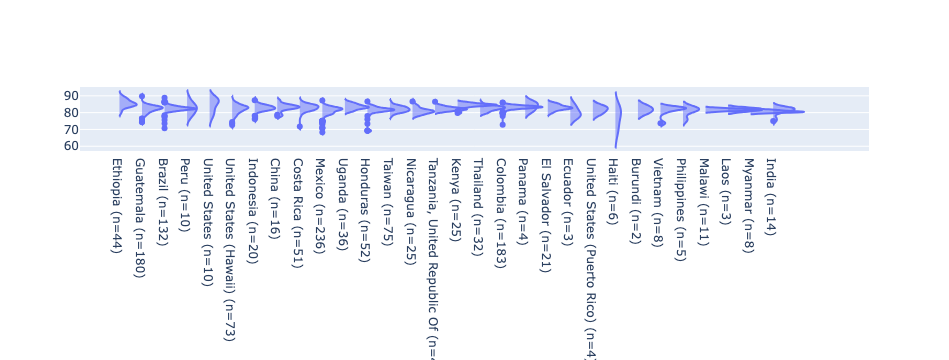

In [21]:
# google "pandas remove groups with size 1"
# https://stackoverflow.com/questions/54584286/pandas-groupby-then-drop-groups-below-specified-size
df = df.groupby('origin').filter(lambda x: len(x) > 1)

fig = go.Figure()
fig.add_trace(go.Violin(x=df.origin, y=df.points,side='positive', width=5))

In [ ]:
# KDE Kernal Perma density estimater. 
# A data swarm, but we show the denisty of the points based on the heights of curve. 

# probability density function 

# It is a histogram with very very small bins so the curve becomes like a smooth curve. 

In [23]:
df = df.groupby('origin').filter(lambda x: len(x) > 30)


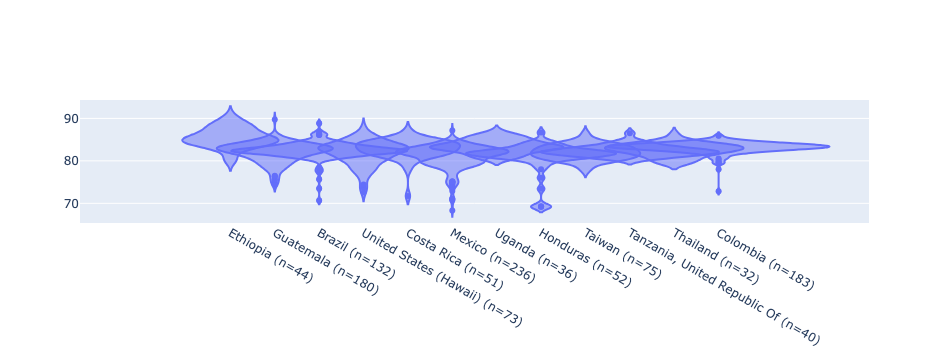

In [25]:
fig = go.Figure()
fig.add_trace(go.Violin(x=df.origin, y=df.points,side='both', width=5))

Looks aesthetically pleasing. (make cool graphs).
A mirrored, KDA, to make pretty shapes.

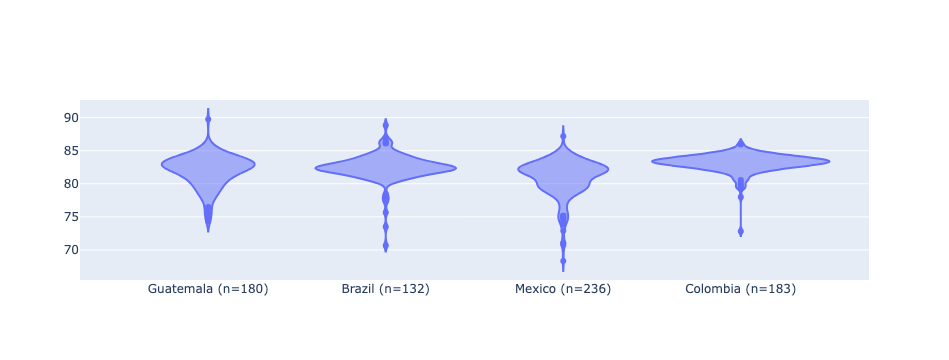

In [27]:
df = df.groupby('origin').filter(lambda x: len(x) > 100)
fig = go.Figure()
fig.add_trace(go.Violin(x=df.origin, y=df.points,side='both', width=1))

In [ ]:
# A picture using these nice shapes, probably looks good.
# A violin graph, meixco looks the best like a violin. 
# I like these plots because it shows the biggest parts are the where more data lays. 

# Histograms are good, sometimes you want bigger bins so the information comes across easier. 
# Wides bins, a summary of things. Get your point across. Sometimes you don't need alot of bins. 
# Gives you an idea of the shape of plot. 
# Number of bins should match the amount of data that is there. (a course summary).

# Parameter of KDE, (the size of window) or bandwidth parameter, wwill say how smooth we should.
# narrow bandwith is a very narrow bingsize 
# this will make the kde more smooth or less smooth. 

In [29]:
df.groupby('origin').points.apply(list)


origin
Brazil (n=132)       [88.83, 86.92, 86.42, 86.17, 86.17, 86.08, 85....
Colombia (n=183)     [86.0, 85.92, 85.25, 85.25, 85.08, 85.08, 85.0...
Guatemala (n=180)    [89.75, 85.92, 85.83, 85.83, 85.5, 85.33, 85.2...
Mexico (n=236)       [87.17, 85.0, 85.0, 84.92, 84.67, 84.5, 84.5, ...
Name: points, dtype: object

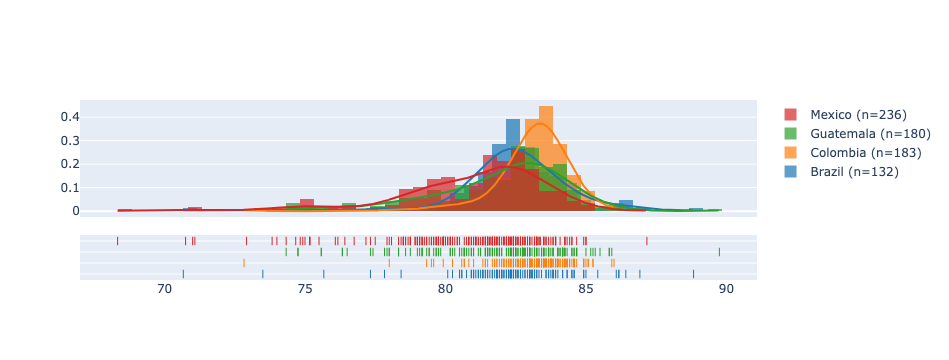

In [31]:
import plotly.figure_factory as ff

# Group data together
hist_data = df.groupby('origin').points.apply(list).values.tolist()
group_labels = df.groupby('origin').points.apply(list).index.values
c
# Create distplot with custom bin_size
fig = ff.create_distplot(hist_data, group_labels, bin_size=[.5]*4)
fig.show()  # USE `fig.show(renderer="png")` FOR ALL GitHub and MarkUs SUBMISSIONS

In [ ]:
# The area under both are the same. 
# They are summarizing in different ways. 
# The Histogram and KDE are disagreeing, beacusse of the way the summarize
# the kde is smoothing, makes it look like there is data on the ends, but there might not actually data there. 

# The rug plot is at the bottom. It is a dataswarm in a slightly different way. You can't tell how much points there are at 
# any point. 

#Kinda busy 
# maybe the colours. 

# always give the sample size.  (thats a rooky mistake)
# 

In [33]:
df

,points,species,owner,origin,farm_name,lot_number,mill,ico_number,company,altitude,...,color,category_two_defects,expiration,certification_body,certification_address,certification_contact,unit_of_measurement,altitude_low_meters,altitude_high_meters,altitude_mean_meters
2,89.75,Arabica,grounds for health admin,Guatemala (n=180),"san marcos barrancas ""san cristobal cuch",NaN,NaN,NaN,NaN,1600 - 1800 m,...,NaN,0,"May 31st, 2011",Specialty Coffee Association,36d0d00a3724338ba7937c52a378d085f2172daa,0878a7d4b9d35ddbf0fe2ce69a2062cceb45a660,m,1600.0,1800.0,1700.0
5,88.83,Arabica,ji-ae ahn,Brazil (n=132),NaN,NaN,NaN,NaN,NaN,NaN,...,Bluish-Green,1,"September 3rd, 2014",Specialty Coffee Institute of Asia,726e4891cf2c9a4848768bd34b668124d12c4224,b70da261fcc84831e3e9620c30a8701540abc200,m,NaN,NaN,NaN
22,87.17,Arabica,roberto licona franco,Mexico (n=236),la herradura,NaN,la herradura,0,NaN,1320,...,Green,0,"July 26th, 2013",AMECAFE,59e396ad6e22a1c22b248f958e1da2bd8af85272,0eb4ee5b3f47b20b049548a2fd1e7d4a2b70d0a7,m,1320.0,1320.0,1320.0
25,86.92,Arabica,nucoffee,Brazil (n=132),fazenda kaquend,NaN,NaN,002/1251/0073,nucoffee,1250m,...,Green,2,"December 2nd, 2012",NUCOFFEE,567f200bcc17a90070cb952647bf88141ad9c80c,aa2ff513ffb9c844462a1fb07c599bce7f3bb53d,m,1250.0,1250.0,1250.0
32,86.42,Arabica,nucoffee,Brazil (n=132),fazenda recreio,NaN,NaN,002/1251/0068,nucoffee,1300,...,Green,2,"December 2nd, 2012",NUCOFFEE,567f200bcc17a90070cb952647bf88141ad9c80c,aa2ff513ffb9c844462a1fb07c599bce7f3bb53d,m,1300.0,1300.0,1300.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1299,71.08,Arabica,jose armando norberto borzani lemini,Mexico (n=236),la vuelta,NaN,"mazatepec, tlatlauquitepec, puebla",11111,cafe colonial de tlatlauquitepec,800,...,Green,24,"September 10th, 2013",AMECAFE,59e396ad6e22a1c22b248f958e1da2bd8af85272,0eb4ee5b3f47b20b049548a2fd1e7d4a2b70d0a7,m,800.0,800.0,800.0
1300,71.00,Arabica,ricardo aaron sampieri marini,Mexico (n=236),la morena,NaN,"tlamatoca, hutusco, ver.",1104351023,NaN,1800,...,Green,0,"July 11th, 2013",AMECAFE,59e396ad6e22a1c22b248f958e1da2bd8af85272,0eb4ee5b3f47b20b049548a2fd1e7d4a2b70d0a7,m,1800.0,1800.0,1800.0
1301,70.75,Arabica,kurt kappeli,Mexico (n=236),various,NaN,f.i.e.c.h.,0016-2847-0001,globus coffee,1000 meters,...,Green,1,"May 5th, 2015",Specialty Coffee Association,36d0d00a3724338ba7937c52a378d085f2172daa,0878a7d4b9d35ddbf0fe2ce69a2062cceb45a660,m,1000.0,1000.0,1000.0
1302,70.67,Arabica,volcafe ltda. - brasil,Brazil (n=132),NaN,2017/2018 - Lot 2,copag,NaN,volcafe ltda.,NaN,...,Green,55,"October 27th, 2018",Brazil Specialty Coffee Association,3297cfa4c538e3dd03f72cc4082c54f7999e1f9d,8900f0bf1d0b2bafe6807a73562c7677d57eb980,m,NaN,NaN,NaN


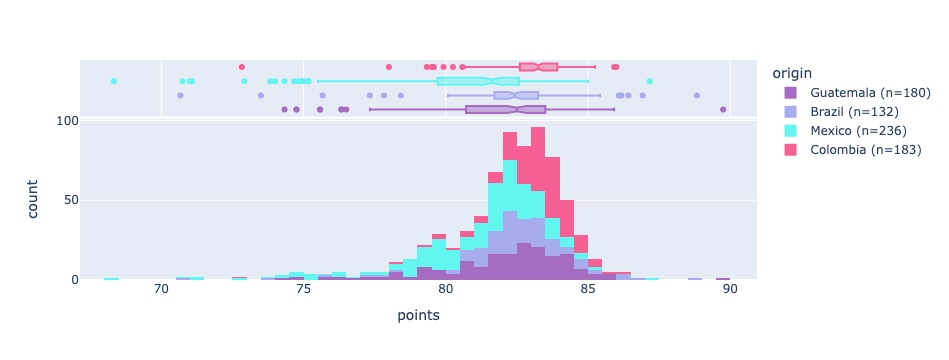

In [38]:
import plotly.express as px
fig = px.histogram(df, x="points", color="origin", marginal="box",
                   color_discrete_sequence=['#A56CC1', '#A6ACEC', '#63F5EF', '#F66095'],
                   hover_data=df.columns) # "box" or "violin" or "rug"
fig.show()  # USE `fig.show(renderer="png")` FOR ALL GitHub and MarkUs SUBMISSIONS


# 1
What's the difference between a bar plot and a histogram, a histogram and a box plot, a box plot and a violin plot (made with a kernel density estimator), and violin plot (made with a kernel density estimator) and a probability density function?


# 2
Can you fit a normal distribution to a sample of data using python? If so, how? Could you use the `.fit()` method of a distribution object from `scipy.stats`  to fit any distribution to any data set and visualize the result? 


# 3
Might you be willing to provide some feedback to us for our Week 03 ChatBot Experience Survey?

Or course it's optional, anonymous, and all that. So no pressure. But it's basically just like the Week 02 optional survey, if you saw that. So hopefully your sense then was that it's not too much trouble to fill out, and you're up for doing so again! Or, perhaps you've not filled one of these out yet, but perhaps you now a have a little feedback to share, or maybe just wanna take a peek and see what these things are all about?

Indeed, the Week 03 optional survey has the exact same structure as the Week 02 optional survey; but, there's a slight difference in that this survey asks you to give your overall 5-start rating of the ChatBot, and to let us know what components of the course you're finding most helpful. ?

 

# office hours tomorrow 4 - 6 
# wednesday 4 - 6
I learned about:
 - Histograms
 - Box plots
 - KDE
 - Mirror KDE
 - Data swarms
 - Putting multiple graphs on top of eachother
 - The importance of picking a bin size
 - The importance of picking bandwidth.
 - Is the graph to busy.
 - 

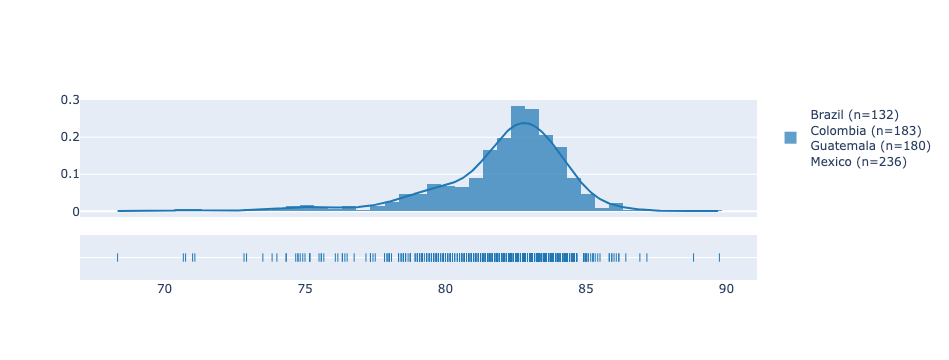

In [52]:
# Group data together
hist_data = [df.groupby('origin').points.apply(list).values.sum()]
group_labels = ["<br>".join(df.groupby('origin').points.apply(list).index.values)]

# Create distplot with custom bin_size
fig = ff.create_distplot(hist_data, group_labels, bin_size=[0.5]*4)
fig.show()  # USE `fig.show(renderer="png")` FOR ALL GitHub and MarkUs SUBMISSIONS

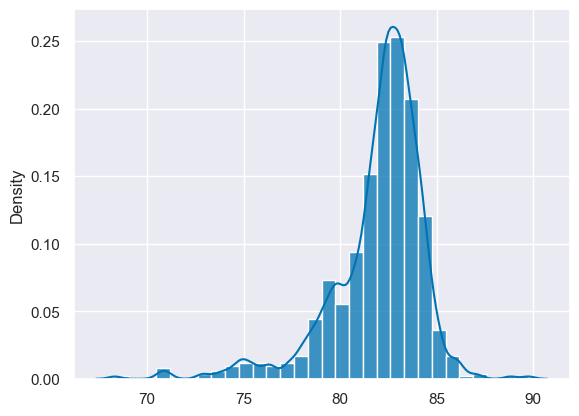

In [54]:
import seaborn as sns
sns.set_theme()
sns.set_palette("colorblind")#sns.set_palette("deep")#sns.set_palette("rocket")
sns.histplot(x=df.groupby('origin').points.apply(list).values.sum(), 
             stat='density', bins=30)
sns.kdeplot(x=df.groupby('origin').points.apply(list).values.sum(), 
            bw_adjust=0.5);

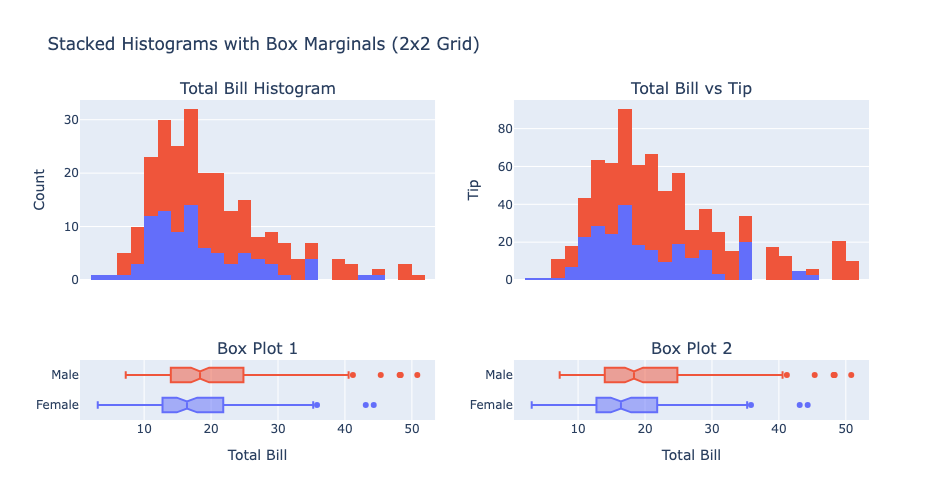

In [56]:
# https://chatgpt.com/share/66edd41b-4be0-8007-a3c8-fc5aca875e7b

import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

# Load the data
df = px.data.tips()

# First figure (histogram + box, with color based on "sex" and stacked bars)
fig1 = px.histogram(df, x="total_bill", color="sex", marginal="box", hover_data=df.columns, barmode="stack")

# Second figure (histogram + box, with color based on "sex" and stacked bars)
fig2 = px.histogram(df, x="total_bill", y="tip", color="sex", marginal="box", hover_data=df.columns, barmode="stack")

# Create a 2x2 subplot layout with adjusted row heights
fig_combined = make_subplots(
    rows=2, cols=2, 
    row_heights=[0.75, 0.25],  # 75% height for the top row, 25% for the bottom row
    subplot_titles=("Total Bill Histogram", "Total Bill vs Tip", "Box Plot 1", "Box Plot 2"),
    shared_xaxes=True, shared_yaxes=False
)

# Add the main histogram traces (both genders) from fig1 to the first subplot (top-left)
for trace in [fig1.data[0], fig1.data[2]]:  # First 2 traces are the stacked histograms
    fig_combined.add_trace(trace, row=1, col=1)

# Add the main histogram traces (both genders) from fig2 to the second subplot (top-right)
for trace in [fig2.data[0], fig2.data[2]]:  # First 2 traces are the stacked histograms
    fig_combined.add_trace(trace, row=1, col=2)

# Add only the box plot traces (bottom row)
fig_combined.add_trace(fig1.data[1], row=2, col=1)  # Box plot from fig1
fig_combined.add_trace(fig2.data[1], row=2, col=2)  # Box plot from fig2
fig_combined.add_trace(fig1.data[3], row=2, col=1)  # Box plot from fig1
fig_combined.add_trace(fig2.data[3], row=2, col=2)  # Box plot from fig2

# Update axes: remove x-axis labels from the top row and add them to the bottom row
fig_combined.update_xaxes(title_text="Total Bill", row=2, col=1)
fig_combined.update_xaxes(title_text="Total Bill", row=2, col=2)

# Update y-axis labels
fig_combined.update_yaxes(title_text="Count", row=1, col=1)
fig_combined.update_yaxes(title_text="Tip", row=1, col=2)

# Apply stacked barmode at the combined layout level
fig_combined.update_layout(
    height=500, width=800, 
    title_text="Stacked Histograms with Box Marginals (2x2 Grid)",
    barmode="stack", showlegend=False
)

# Show the combined figure
fig_combined.show()  # USE ...`.show(renderer="png")` FOR ALL GitHub and MarkUs SUBMISSIONS

Same bins, but how much you tipped

Is the plot on the right a histogram?

Look carefully, 

idea, just overlap the KDE. (don't put both KDE and histogram)

Bokeh, iteractive where viewers can interact with the graph. (data bashboards)

Data journalism, presenting datqa in cool ways to people. 

In [60]:
df.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


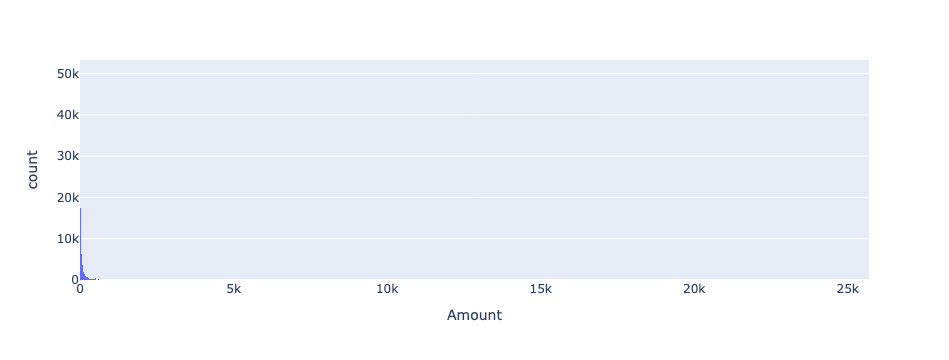

In [69]:
df = pd.read_csv("https://raw.githubusercontent.com/nsethi31/Kaggle-Data-Credit-Card-Fraud-Detection/master/creditcard.csv")
fig = px.histogram(df, x="Amount")
fig.show()  # USE `fig.show(renderer="png")` FOR ALL GitHub and MarkUs SUBMISSIONS

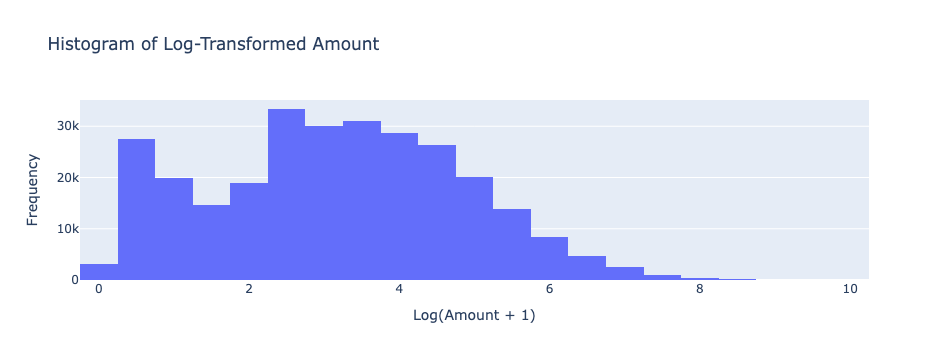

In [63]:
import numpy as np

df['Log_Amount'] = np.log1p(df['Amount'])  # log1p is used for log(1 + x)
fig = px.histogram(df, x="Log_Amount", nbins=30, 
                   title="Histogram of Log-Transformed Amount")
fig.update_xaxes(title_text="Log(Amount + 1)")
fig.update_yaxes(title_text="Frequency")
fig.show()  # USE `fig.show(renderer="png")` FOR ALL GitHub and MarkUs SUBMISSIONS

Sample mean statistic 10.003 
estimates the population mean 10 parameter

Sample standard deviation statistic 1.999 
estimates the population standard deviation 2 parameter


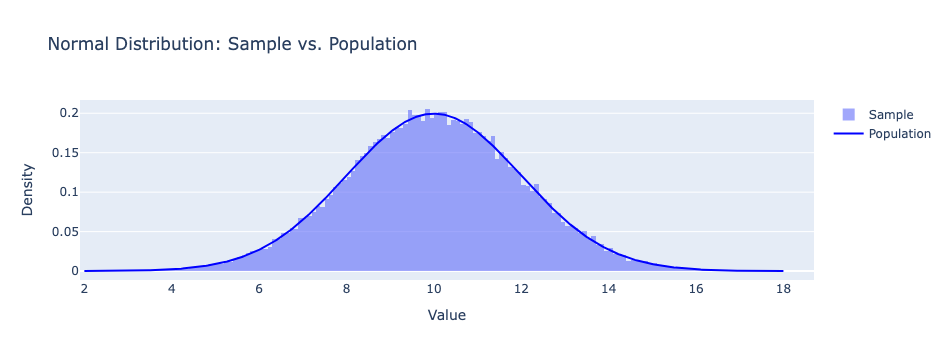

In [95]:
from scipy import stats

# Parameters
location_μ = 10  # population mean
scale_σ = 2  # population standard deviation

normal_distribution = stats.norm(loc=location_μ, scale=scale_σ)  # population

# Sample
n = 50000
x = normal_distribution.rvs(size=n)

# Statistics
x_bar = x.mean()
ssd = x.std()
print("Sample mean statistic", x_bar.round(3), 
      "\nestimates the population mean", location_μ, "parameter\n")
print("Sample standard deviation statistic", ssd.round(3), 
      "\nestimates the population standard deviation", scale_σ, "parameter")

# Create a range for the population
grid_size = 500
support_grid = np.linspace(location_μ - 4*scale_σ, 
                           location_μ + 4*scale_σ, grid_size)

# mathematical function representing the population
pdf = normal_distribution.pdf(support_grid)  # probability density function

fig = go.Figure()
fig.add_trace(go.Histogram(x=x, histnorm='probability density', 
                           name='Sample', opacity=0.6))
fig.add_trace(go.Scatter(x=support_grid, y=pdf, mode='lines', 
                         name='Population', line=dict(color='blue')))
fig.update_layout(title='Normal Distribution: Sample vs. Population',
                  xaxis_title='Value', yaxis_title='Density',
                  barmode='overlay')
fig.show()  # USE `fig.show(renderer="png")` FOR ALL GitHub and MarkUs SUBMISSIONS

Sample mean
median
mean
standard deviation  instead of variance

With the mean and standard deviation, is able to describe the data.

Normal distribution is different than the KDE. 
A mathematical idea of a population, the bell curve. 

The more data, the more the sample mean (normal distribution) fits inside.

If you want your sample to represent the population, you want your sample really large. If you only sample 1/4 of the course, then you have a bias dependent sample. You want an independent sample. 

independnce - the sample needs to be not influenced by the person before it. sample needs to be independence. 